In [1]:
pip install plotly

DEPRECATION: Configuring installation scheme with distutils config files is deprecated and will no longer work in the near future. If you are using a Homebrew or Linuxbrew Python, please see discussion at https://github.com/Homebrew/homebrew-core/issues/76621
You should consider upgrading via the '/usr/local/opt/python@3.9/bin/python3.9 -m pip install --upgrade pip' command.
Note: you may need to restart the kernel to use updated packages.


In [2]:
import plotly.graph_objs as go
from plotly.offline import iplot

def plot_dataset(df, title):
    data = []
    value = go.Scatter(
        x=df.index,
        y=df.value,
        mode="lines",
        name="values",
        marker=dict(),
        text=df.index,
        line=dict(color="rgba(0,0,0, 0.3)"),
    )
    data.append(value)

    layout = dict(
        title=title,
        xaxis=dict(title="Date", ticklen=5, zeroline=False),
        yaxis=dict(title="Value", ticklen=5, zeroline=False),
    )

    fig = dict(data=data, layout=layout)
    iplot(fig)

In [3]:
pip install pandas

DEPRECATION: Configuring installation scheme with distutils config files is deprecated and will no longer work in the near future. If you are using a Homebrew or Linuxbrew Python, please see discussion at https://github.com/Homebrew/homebrew-core/issues/76621
You should consider upgrading via the '/usr/local/opt/python@3.9/bin/python3.9 -m pip install --upgrade pip' command.
Note: you may need to restart the kernel to use updated packages.


In [4]:
import pandas as pd

df = pd.read_csv('./PJME_hourly.csv')

df = df.set_index(['Datetime'])
df.index = pd.to_datetime(df.index)
if not df.index.is_monotonic:
    df = df.sort_index()
    
df

,PJME_MW
Datetime,
2002-01-01 01:00:00,30393.0
2002-01-01 02:00:00,29265.0
2002-01-01 03:00:00,28357.0
2002-01-01 04:00:00,27899.0
2002-01-01 05:00:00,28057.0
...,...
2018-08-02 20:00:00,44057.0
2018-08-02 21:00:00,43256.0
2018-08-02 22:00:00,41552.0


In [5]:

df = df.rename(columns={'PJME_MW': 'value'})

df



,value
Datetime,
2002-01-01 01:00:00,30393.0
2002-01-01 02:00:00,29265.0
2002-01-01 03:00:00,28357.0
2002-01-01 04:00:00,27899.0
2002-01-01 05:00:00,28057.0
...,...
2018-08-02 20:00:00,44057.0
2018-08-02 21:00:00,43256.0
2018-08-02 22:00:00,41552.0


In [6]:
plot_dataset(df, title='PJM East (PJME) Region: estimated energy consumption in Megawatts (MW)')

In [7]:
df_lastyear = df.tail(365)
plot_dataset(df_lastyear, title='PJM East (PJME) Region: estimated energy consumption in Megawatts (MW)')

In [8]:
def generate_time_lags(df, n_lags):
    df_n = df.copy()
    for n in range(1, n_lags + 1):
        df_n[f"lag{n}"] = df_n["value"].shift(n)
    df_n = df_n.iloc[n_lags:]
    return df_n
    
input_dim = 100

df_generated = generate_time_lags(df, input_dim)
df_generated

/var/folders/63/jxx75fkj60994837s_qvrxt00000gn/T/ipykernel_60874/570688505.py:4: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead.  To get a de-fragmented frame, use `newframe = frame.copy()`



,value,lag1,lag2,lag3,lag4,lag5,lag6,lag7,lag8,lag9,...,lag91,lag92,lag93,lag94,lag95,lag96,lag97,lag98,lag99,lag100
Datetime,,,,,,,,,,,,,,,,,,,,,
2002-01-05 05:00:00,26822.0,26669.0,27034.0,27501.0,28635.0,30924.0,33202.0,35368.0,36762.0,37539.0,...,30692.0,29943.0,29595.0,29308.0,28654.0,28057.0,27899.0,28357.0,29265.0,30393.0
2002-01-05 06:00:00,27399.0,26822.0,26669.0,27034.0,27501.0,28635.0,30924.0,33202.0,35368.0,36762.0,...,31395.0,30692.0,29943.0,29595.0,29308.0,28654.0,28057.0,27899.0,28357.0,29265.0
2002-01-05 07:00:00,28557.0,27399.0,26822.0,26669.0,27034.0,27501.0,28635.0,30924.0,33202.0,35368.0,...,31496.0,31395.0,30692.0,29943.0,29595.0,29308.0,28654.0,28057.0,27899.0,28357.0
2002-01-05 08:00:00,29709.0,28557.0,27399.0,26822.0,26669.0,27034.0,27501.0,28635.0,30924.0,33202.0,...,31031.0,31496.0,31395.0,30692.0,29943.0,29595.0,29308.0,28654.0,28057.0,27899.0
2002-01-05 09:00:00,31241.0,29709.0,28557.0,27399.0,26822.0,26669.0,27034.0,27501.0,28635.0,30924.0,...,30360.0,31031.0,31496.0,31395.0,30692.0,29943.0,29595.0,29308.0,28654.0,28057.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2018-08-02 20:00:00,44057.0,45641.0,46760.0,46816.0,46989.0,47154.0,46534.0,45372.0,43954.0,42189.0,...,28389.0,30789.0,33747.0,36581.0,37870.0,39089.0,40517.0,40709.0,39906.0,38637.0
2018-08-02 21:00:00,43256.0,44057.0,45641.0,46760.0,46816.0,46989.0,47154.0,46534.0,45372.0,43954.0,...,26779.0,28389.0,30789.0,33747.0,36581.0,37870.0,39089.0,40517.0,40709.0,39906.0
2018-08-02 22:00:00,41552.0,43256.0,44057.0,45641.0,46760.0,46816.0,46989.0,47154.0,46534.0,45372.0,...,25675.0,26779.0,28389.0,30789.0,33747.0,36581.0,37870.0,39089.0,40517.0,40709.0


In [9]:
df_features = (
                df
                .assign(hour = df.index.hour)
                .assign(day = df.index.day)
                .assign(month = df.index.month)
                .assign(day_of_week = df.index.dayofweek)
                .assign(week_of_year = df.index.week)
              )
df_features

/var/folders/63/jxx75fkj60994837s_qvrxt00000gn/T/ipykernel_60874/3041815222.py:7: FutureWarning:

weekofyear and week have been deprecated, please use DatetimeIndex.isocalendar().week instead, which returns a Series.  To exactly reproduce the behavior of week and weekofyear and return an Index, you may call pd.Int64Index(idx.isocalendar().week)



,value,hour,day,month,day_of_week,week_of_year
Datetime,,,,,,
2002-01-01 01:00:00,30393.0,1,1,1,1,1
2002-01-01 02:00:00,29265.0,2,1,1,1,1
2002-01-01 03:00:00,28357.0,3,1,1,1,1
2002-01-01 04:00:00,27899.0,4,1,1,1,1
2002-01-01 05:00:00,28057.0,5,1,1,1,1
...,...,...,...,...,...,...
2018-08-02 20:00:00,44057.0,20,2,8,3,31
2018-08-02 21:00:00,43256.0,21,2,8,3,31
2018-08-02 22:00:00,41552.0,22,2,8,3,31


In [10]:
pip install sklearn

DEPRECATION: Configuring installation scheme with distutils config files is deprecated and will no longer work in the near future. If you are using a Homebrew or Linuxbrew Python, please see discussion at https://github.com/Homebrew/homebrew-core/issues/76621
You should consider upgrading via the '/usr/local/opt/python@3.9/bin/python3.9 -m pip install --upgrade pip' command.
Note: you may need to restart the kernel to use updated packages.


In [11]:
# the fency sklearn way to do one hot encoding:
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import OneHotEncoder

def onehot_encode(df, onehot_columns):
    ct = ColumnTransformer(
        [('onehot', OneHotEncoder(drop='first'), onehot_columns)],
        remainder='passthrough'
        )
    return ct.fit_transform(df)

onehot_columns = ['hour'] #['month','day','day_of_week','week_of_year'])
onehot_encoded = onehot_encode(df_features, onehot_columns)
onehot_encoded

<145366x28 sparse matrix of type '<class 'numpy.float64'>'
	with 845379 stored elements in Compressed Sparse Row format>

In [12]:
import numpy as np
def generate_cyclical_features(df, col_name, period, start_num=0):
    kwargs = {
        f'sin_{col_name}' : lambda x: np.sin(2*np.pi*(df[col_name]-start_num)/period),
        f'cos_{col_name}' : lambda x: np.cos(2*np.pi*(df[col_name]-start_num)/period)    
             }
    return df.assign(**kwargs).drop(columns=[col_name])

df_features = generate_cyclical_features(df_features, 'hour', 24, 0)
#df_features = generate_cyclical_features(df_features, 'day_of_week', 7, 0)
#df_features = generate_cyclical_features(df_features, 'month', 12, 1)
#df_features = generate_cyclical_features(df_features, 'week_of_year', 52, 0)

df_features

,value,day,month,day_of_week,week_of_year,sin_hour,cos_hour
Datetime,,,,,,,
2002-01-01 01:00:00,30393.0,1,1,1,1,0.258819,0.965926
2002-01-01 02:00:00,29265.0,1,1,1,1,0.500000,0.866025
2002-01-01 03:00:00,28357.0,1,1,1,1,0.707107,0.707107
2002-01-01 04:00:00,27899.0,1,1,1,1,0.866025,0.500000
2002-01-01 05:00:00,28057.0,1,1,1,1,0.965926,0.258819
...,...,...,...,...,...,...,...
2018-08-02 20:00:00,44057.0,2,8,3,31,-0.866025,0.500000
2018-08-02 21:00:00,43256.0,2,8,3,31,-0.707107,0.707107
2018-08-02 22:00:00,41552.0,2,8,3,31,-0.500000,0.866025


In [13]:
pip install holidays

DEPRECATION: Configuring installation scheme with distutils config files is deprecated and will no longer work in the near future. If you are using a Homebrew or Linuxbrew Python, please see discussion at https://github.com/Homebrew/homebrew-core/issues/76621
     |████████████████████████████████| 155 kB 8.1 MB/s eta 0:00:01
     |████████████████████████████████| 47 kB 20.9 MB/s eta 0:00:01
     |████████████████████████████████| 5.4 MB 43.0 MB/s eta 0:00:01
  Created wheel for pymeeus: filename=PyMeeus-0.5.11-py3-none-any.whl size=730973 sha256=ac48e50aee90fb48475614b4c968e7700ca02bc4acfabade398015ca3042ebc5
  Stored in directory: /Users/macanbaz/Library/Caches/pip/wheels/33/3d/82/4579e9cca41ff991140b2e050bc6df3a38292f26e4fa06b15d
Successfully built pymeeus
  DEPRECATION: Configuring installation scheme with distutils config files is deprecated and will no longer work in the near future. If you are using a Homebrew or Linuxbrew Python, please see discussion at https://github.com/Hom

In [14]:
from datetime import date
import holidays

us_holidays = holidays.US()

def is_holiday(date):
    date = date.replace(hour = 0)
    return 1 if (date in us_holidays) else 0

def add_holiday_col(df, holidays):
    return df.assign(is_holiday = df.index.to_series().apply(is_holiday))


df_features = add_holiday_col(df_features, us_holidays)
df_features

,value,day,month,day_of_week,week_of_year,sin_hour,cos_hour,is_holiday
Datetime,,,,,,,,
2002-01-01 01:00:00,30393.0,1,1,1,1,0.258819,0.965926,1
2002-01-01 02:00:00,29265.0,1,1,1,1,0.500000,0.866025,1
2002-01-01 03:00:00,28357.0,1,1,1,1,0.707107,0.707107,1
2002-01-01 04:00:00,27899.0,1,1,1,1,0.866025,0.500000,1
2002-01-01 05:00:00,28057.0,1,1,1,1,0.965926,0.258819,1
...,...,...,...,...,...,...,...,...
2018-08-02 20:00:00,44057.0,2,8,3,31,-0.866025,0.500000,0
2018-08-02 21:00:00,43256.0,2,8,3,31,-0.707107,0.707107,0
2018-08-02 22:00:00,41552.0,2,8,3,31,-0.500000,0.866025,0


When it comes to feature engineering, possibilities are seemingly limitless, and there is certainly room for some experimentation and creativity. The good news is there are already quite a few packages out there that do the job for us, like meteostat for historical weather data or yfinance for stock market data. The bad one is, there is generally no clear answer to which additional features may improve the model performance without actually trying them out.
Just an idea, one can also try to include weather data, e.g., temperature, humidity, precipitation, wind, rain, snow, and so on, to learn how the weather affects the energy consumption in a given hour, day, week, and month.

In [15]:
from sklearn.model_selection import train_test_split

def feature_label_split(df, target_col):
    y = df[[target_col]]
    X = df.drop(columns=[target_col])
    return X, y

def train_val_test_split(df, target_col, test_ratio):
    val_ratio = test_ratio / (1 - test_ratio)
    X, y = feature_label_split(df, target_col)
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=test_ratio, shuffle=False)
    X_train, X_val, y_train, y_val = train_test_split(X_train, y_train, test_size=val_ratio, shuffle=False)
    return X_train, X_val, X_test, y_train, y_val, y_test

X_train, X_val, X_test, y_train, y_val, y_test = train_val_test_split(df_features, 'value', 0.2)


In [16]:
X_train

,day,month,day_of_week,week_of_year,sin_hour,cos_hour,is_holiday
Datetime,,,,,,,
2002-01-01 01:00:00,1,1,1,1,0.258819,0.965926,1
2002-01-01 02:00:00,1,1,1,1,0.500000,0.866025,1
2002-01-01 03:00:00,1,1,1,1,0.707107,0.707107,1
2002-01-01 04:00:00,1,1,1,1,0.866025,0.500000,1
2002-01-01 05:00:00,1,1,1,1,0.965926,0.258819,1
...,...,...,...,...,...,...,...
2011-12-14 20:00:00,14,12,2,50,-0.866025,0.500000,0
2011-12-14 21:00:00,14,12,2,50,-0.707107,0.707107,0
2011-12-14 22:00:00,14,12,2,50,-0.500000,0.866025,0


In [17]:
X_test

,day,month,day_of_week,week_of_year,sin_hour,cos_hour,is_holiday
Datetime,,,,,,,
2015-04-09 15:00:00,9,4,3,15,-0.707107,-7.071068e-01,0
2015-04-09 16:00:00,9,4,3,15,-0.866025,-5.000000e-01,0
2015-04-09 17:00:00,9,4,3,15,-0.965926,-2.588190e-01,0
2015-04-09 18:00:00,9,4,3,15,-1.000000,-1.836970e-16,0
2015-04-09 19:00:00,9,4,3,15,-0.965926,2.588190e-01,0
...,...,...,...,...,...,...,...
2018-08-02 20:00:00,2,8,3,31,-0.866025,5.000000e-01,0
2018-08-02 21:00:00,2,8,3,31,-0.707107,7.071068e-01,0
2018-08-02 22:00:00,2,8,3,31,-0.500000,8.660254e-01,0


Scaling the values in your dataset is a highly recommended practice for neural networks, as it is for other machine learning techniques. It speeds up the learning by making it easier for the model to update the weights. You can easily do that by using Scikit-learn’s scalers, MinMaxScaler, RobustScaler, Standard Scaler, and so on.

In [18]:
from sklearn.preprocessing import MinMaxScaler, StandardScaler, MaxAbsScaler, RobustScaler

def get_scaler(scaler):
    scalers = {
        "minmax": MinMaxScaler,
        "standard": StandardScaler,
        "maxabs": MaxAbsScaler,
        "robust": RobustScaler,
    }
    return scalers.get(scaler.lower())()
    
scaler = get_scaler('robust')

X_train_arr = scaler.fit_transform(X_train)
X_val_arr = scaler.transform(X_val)
X_test_arr = scaler.transform(X_test)

y_train_arr = scaler.fit_transform(y_train)
y_val_arr = scaler.transform(y_val)
y_test_arr = scaler.transform(y_test)

PyTorch’s DataLoader class, a Python iterable over Dataset, loads the data and splits them into batches for you to do mini-batch training. The most important argument for the DataLoader constructor is the Dataset, which indicates a dataset object to load data from. There are mainly two types of datasets, one being map-style datasets and the other iterable-style datasets.

In [19]:
pip install torchvision

DEPRECATION: Configuring installation scheme with distutils config files is deprecated and will no longer work in the near future. If you are using a Homebrew or Linuxbrew Python, please see discussion at https://github.com/Homebrew/homebrew-core/issues/76621
You should consider upgrading via the '/usr/local/opt/python@3.9/bin/python3.9 -m pip install --upgrade pip' command.
Note: you may need to restart the kernel to use updated packages.


In [20]:
import torch
from torch.utils.data import TensorDataset, DataLoader

batch_size = 64

train_features = torch.Tensor(X_train_arr)
train_targets = torch.Tensor(y_train_arr)
val_features = torch.Tensor(X_val_arr)
val_targets = torch.Tensor(y_val_arr)
test_features = torch.Tensor(X_test_arr)
test_targets = torch.Tensor(y_test_arr)

train = TensorDataset(train_features, train_targets)
val = TensorDataset(val_features, val_targets)
test = TensorDataset(test_features, test_targets)

train_loader = DataLoader(train, batch_size=batch_size, shuffle=False, drop_last=True)
val_loader = DataLoader(val, batch_size=batch_size, shuffle=False, drop_last=True)
test_loader = DataLoader(test, batch_size=batch_size, shuffle=False, drop_last=True)
test_loader_one = DataLoader(test, batch_size=1, shuffle=False, drop_last=True)

You may notice an extra DataLoader with the batch size of 1 and wonder why the hell we need it. The short answer, it’s not a must-have but a nice-to-have. Like mini-batch training, you can also do mini-batch testing to evaluate the model’s performance, which is likely much faster due to tensor operations. However, doing so will drop the last time steps that couldn’t make up a batch, leading to losing these data points. This will not likely result in a significant change in your error metrics unless your batch size is huge.

### Vanilla RNN

By extending PyTorch’s nn.Module, a base class for all neural network modules, we define our RNN module as follows. Our RNN module will have one or more RNN layers connected by a fully connected layer to convert the RNN output into desired output shape. We also need to define the forward propagation function as a class method, called forward(). This method is executed sequentially, passing the inputs and the zero-initialized hidden state. Nonetheless, PyTorch automatically creates and computes the backpropagation function backward().

In [21]:
from torch import nn
class RNNModel(nn.Module):
    def __init__(self, input_dim, hidden_dim, layer_dim, output_dim, dropout_prob):
        super(RNNModel, self).__init__()

        # Defining the number of layers and the nodes in each layer
        self.hidden_dim = hidden_dim
        self.layer_dim = layer_dim

        # RNN layers
        self.rnn = nn.RNN(
            input_dim, hidden_dim, layer_dim, batch_first=True, dropout=dropout_prob
        )
        # Fully connected layer
        self.fc = nn.Linear(hidden_dim, output_dim)

    def forward(self, x):
        # Initializing hidden state for first input with zeros
        h0 = torch.zeros(self.layer_dim, x.size(0), self.hidden_dim).requires_grad_()

        # Forward propagation by passing in the input and hidden state into the model
        out, h0 = self.rnn(x, h0.detach())

        # Reshaping the outputs in the shape of (batch_size, seq_length, hidden_size)
        # so that it can fit into the fully connected layer
        out = out[:, -1, :]

        # Convert the final state to our desired output shape (batch_size, output_dim)
        out = self.fc(out)
        return out

Vanilla RNN has one shortcoming, though. Simple RNNs can connect previous information to the current one, where the temporal gap between the relevant past information and the current one is small. As that gap grows, RNNs become less capable of learning the long-term dependencies. This is where LSTM comes for help.

### Long Short-Term Memory (LSTM)
Long Short-Term Memory, LSTM for short, is a special type of recurrent network capable of learning long-term dependencies and tends to work much better than the standard version on a wide variety of tasks. RNNs on steroids, so to speak.

In [22]:
class LSTMModel(nn.Module):
    def __init__(self, input_dim, hidden_dim, layer_dim, output_dim, dropout_prob):
        super(LSTMModel, self).__init__()

        # Defining the number of layers and the nodes in each layer
        self.hidden_dim = hidden_dim
        self.layer_dim = layer_dim

        # LSTM layers
        self.lstm = nn.LSTM(
            input_dim, hidden_dim, layer_dim, batch_first=True, dropout=dropout_prob
        )

        # Fully connected layer
        self.fc = nn.Linear(hidden_dim, output_dim)

    def forward(self, x):
        # Initializing hidden state for first input with zeros
        h0 = torch.zeros(self.layer_dim, x.size(0), self.hidden_dim).requires_grad_()

        # Initializing cell state for first input with zeros
        c0 = torch.zeros(self.layer_dim, x.size(0), self.hidden_dim).requires_grad_()

        # We need to detach as we are doing truncated backpropagation through time (BPTT)
        # If we don't, we'll backprop all the way to the start even after going through another batch
        # Forward propagation by passing in the input, hidden state, and cell state into the model
        out, (hn, cn) = self.lstm(x, (h0.detach(), c0.detach()))

        # Reshaping the outputs in the shape of (batch_size, seq_length, hidden_size)
        # so that it can fit into the fully connected layer
        out = out[:, -1, :]

        # Convert the final state to our desired output shape (batch_size, output_dim)
        out = self.fc(out)

        return out

### Gated Recurrent Unit (GRU)

Gated Recurrent Units (GRU) is a slightly more streamlined variant that provides comparable performance and considerably faster computation. Like LSTMs, they also capture long-term dependencies, but they do so by using reset and update gates without any cell state.

While the update gate determines how much of the past information needs to be kept, the reset gate decides how much of the past information to forget. Doing fewer tensor operations, GRUs are often faster and require less memory than LSTMs. As you see below, its model class is almost identical to the RNN’s.


In [23]:
class GRUModel(nn.Module):
    def __init__(self, input_dim, hidden_dim, layer_dim, output_dim, dropout_prob):
        super(GRUModel, self).__init__()

        # Defining the number of layers and the nodes in each layer
        self.layer_dim = layer_dim
        self.hidden_dim = hidden_dim

        # GRU layers
        self.gru = nn.GRU(
            input_dim, hidden_dim, layer_dim, batch_first=True, dropout=dropout_prob
        )

        # Fully connected layer
        self.fc = nn.Linear(hidden_dim, output_dim)

    def forward(self, x):
        # Initializing hidden state for first input with zeros
        h0 = torch.zeros(self.layer_dim, x.size(0), self.hidden_dim).requires_grad_()

        # Forward propagation by passing in the input and hidden state into the model
        out, _ = self.gru(x, h0.detach())

        # Reshaping the outputs in the shape of (batch_size, seq_length, hidden_size)
        # so that it can fit into the fully connected layer
        out = out[:, -1, :]

        # Convert the final state to our desired output shape (batch_size, output_dim)
        out = self.fc(out)

        return out

Similar to the trick we do with scalers, we can also easily switch between these models we just created.

In [24]:
def get_model(model, model_params):
    models = {
        "rnn": RNNModel,
        "lstm": LSTMModel,
        "gru": GRUModel,
    }
    return models.get(model.lower())(**model_params)

### Training the model
Let’s start by creating the main framework for training the models. There are probably heaps of ways to do this, and one of them is to use a helper, or a wrapper, class that holds the training, validation, and evaluation methods. First, we need to have a model class, a loss function to calculate the losses, and an optimizer to update the network's weights.

If you’re familiar with neural networks, you already know that training them is a rather repetitive process, looping back and forth between forward-prop and back-prop. I find it useful to have one level of abstraction, a train step function or wrapper, to combine these repetitive steps.

In [25]:
class Optimization:
    def __init__(self, model, loss_fn, optimizer):
        self.model = model
        self.loss_fn = loss_fn
        self.optimizer = optimizer
        self.train_losses = []
        self.val_losses = []
    
    def train_step(self, x, y):
        # Sets model to train mode
        self.model.train()

        # Makes predictions
        yhat = self.model(x)

        # Computes loss
        loss = self.loss_fn(y, yhat)

        # Computes gradients
        loss.backward()

        # Updates parameters and zeroes gradients
        self.optimizer.step()
        self.optimizer.zero_grad()

        # Returns the loss
        return loss.item()
    
    def train(self, train_loader, val_loader, batch_size=64, n_epochs=50, n_features=1):
        model_path = f'models/{self.model}_{datetime.now().strftime("%Y-%m-%d %H:%M:%S")}'
        # Just right before the actual usage
        device = torch.device('cuda' if torch.cuda.is_available() else 'cpu') #cuda or pyopencl
        
        for epoch in range(1, n_epochs + 1):
            batch_losses = []
            for x_batch, y_batch in train_loader:
                x_batch = x_batch.view([batch_size, -1, n_features]).to(device)
                y_batch = y_batch.to(device)
                loss = self.train_step(x_batch, y_batch)
                batch_losses.append(loss)
            training_loss = np.mean(batch_losses)
            self.train_losses.append(training_loss)

            with torch.no_grad():
                batch_val_losses = []
                for x_val, y_val in val_loader:
                    x_val = x_val.view([batch_size, -1, n_features]).to(device)
                    y_val = y_val.to(device)
                    self.model.eval()
                    yhat = self.model(x_val)
                    val_loss = self.loss_fn(y_val, yhat).item()
                    batch_val_losses.append(val_loss)
                validation_loss = np.mean(batch_val_losses)
                self.val_losses.append(validation_loss)

            if (epoch <= 10) | (epoch % 50 == 0):
                print(
                    f"[{epoch}/{n_epochs}] Training loss: {training_loss:.4f}\t Validation loss: {validation_loss:.4f}"
                )

        torch.save(self.model.state_dict(), model_path)
        
    def evaluate(self, test_loader, batch_size=1, n_features=1):
        # Just right before the actual usage
        device = torch.device('cuda' if torch.cuda.is_available() else 'cpu') #cuda or pyopencl
        with torch.no_grad():
            predictions = []
            values = []
            for x_test, y_test in test_loader:
                x_test = x_test.view([batch_size, -1, n_features]).to(device)
                y_test = y_test.to(device)
                self.model.eval()
                yhat = self.model(x_test)
                predictions.append(yhat.to(device).detach().numpy())
                values.append(y_test.to(device).detach().numpy())

        return predictions, values

    def plot_losses(self):
        plt.plot(self.train_losses, label="Training loss")
        plt.plot(self.val_losses, label="Validation loss")
        plt.legend()
        plt.title("Losses")
        plt.show()
        plt.close()

### Training
So far, we have prepared our dataset, defined our model classes and the wrapper class. We need to put all of them together. You can find some of the hyperparameters defined in the code snippet below, and I encourage you to play with them as you wish. The code below will build an LSTM model using the module we defined earlier. You can also build RNN or GRU models by quickly changing the input of the function get_model from “lstm” to a model of your choice. Without further ado, let’s start training our model.

In [27]:
pip install matplotlib

DEPRECATION: Configuring installation scheme with distutils config files is deprecated and will no longer work in the near future. If you are using a Homebrew or Linuxbrew Python, please see discussion at https://github.com/Homebrew/homebrew-core/issues/76621
     |████████████████████████████████| 7.2 MB 7.5 MB/s eta 0:00:01
     |████████████████████████████████| 61 kB 1.6 MB/s  eta 0:00:01
  DEPRECATION: Configuring installation scheme with distutils config files is deprecated and will no longer work in the near future. If you are using a Homebrew or Linuxbrew Python, please see discussion at https://github.com/Homebrew/homebrew-core/issues/76621
  DEPRECATION: Configuring installation scheme with distutils config files is deprecated and will no longer work in the near future. If you are using a Homebrew or Linuxbrew Python, please see discussion at https://github.com/Homebrew/homebrew-core/issues/76621
DEPRECATION: Configuring installation scheme with distutils config files is depr

[1/20] Training loss: 0.4695	 Validation loss: 0.4122
[2/20] Training loss: 0.4223	 Validation loss: 0.3904
[3/20] Training loss: 0.3263	 Validation loss: 0.2904
[4/20] Training loss: 0.2326	 Validation loss: 0.2535
[5/20] Training loss: 0.2131	 Validation loss: 0.2282
[6/20] Training loss: 0.2024	 Validation loss: 0.2200
[7/20] Training loss: 0.1950	 Validation loss: 0.2087
[8/20] Training loss: 0.1906	 Validation loss: 0.2018
[9/20] Training loss: 0.1880	 Validation loss: 0.1969
[10/20] Training loss: 0.1854	 Validation loss: 0.1952


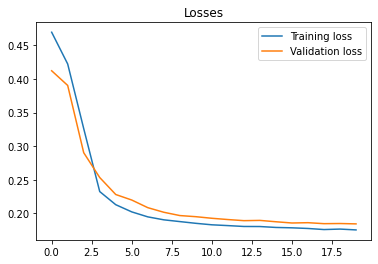

In [29]:
from datetime import datetime
import torch.optim as optim
import torch
import matplotlib.pyplot as plt

input_dim = len(X_train.columns)
output_dim = 1
hidden_dim = 64
layer_dim = 3
batch_size = 64
dropout = 0.2
n_epochs = 20
learning_rate = 1e-3
weight_decay = 1e-6

model_params = {'input_dim': input_dim,
                'hidden_dim' : hidden_dim,
                'layer_dim' : layer_dim,
                'output_dim' : output_dim,
                'dropout_prob' : dropout}

model = get_model('lstm', model_params)

loss_fn = nn.MSELoss(reduction="mean")
optimizer = optim.Adam(model.parameters(), lr=learning_rate, weight_decay=weight_decay)

opt = Optimization(model=model, loss_fn=loss_fn, optimizer=optimizer)
opt.train(train_loader, val_loader, batch_size=batch_size, n_epochs=n_epochs, n_features=input_dim)
opt.plot_losses()

predictions, values = opt.evaluate(test_loader_one, batch_size=1, n_features=input_dim)

As you may recall, we trained our network with standardized inputs; therefore, all the model's predictions are also scaled. Also, after using batching in our evaluation method, all of our predictions are now in batches. To calculate error metrics and plot these predictions, we need first to reduce these multi-dimensional tensors to a one-dimensional vector, i.e., flatten, and then apply inverse_transform() to get the predictions' real values.

In [30]:
def inverse_transform(scaler, df, columns):
    for col in columns:
        df[col] = scaler.inverse_transform(df[col])
    return df


def format_predictions(predictions, values, df_test, scaler):
    vals = np.concatenate(values, axis=0).ravel()
    preds = np.concatenate(predictions, axis=0).ravel()
    df_result = pd.DataFrame(data={"value": vals, "prediction": preds}, index=df_test.head(len(vals)).index)
    df_result = df_result.sort_index()
    df_result = inverse_transform(scaler, df_result, [["value", "prediction"]])
    return df_result


df_result = format_predictions(predictions, values, X_test, scaler)

In [31]:
df_result

,value,prediction
Datetime,,
2015-04-09 15:00:00,32204.0,30554.398438
2015-04-09 16:00:00,32049.0,30303.214844
2015-04-09 17:00:00,32209.0,30311.095703
2015-04-09 18:00:00,32707.0,30613.802734
2015-04-09 19:00:00,33012.0,31058.716797
...,...,...
2018-08-02 20:00:00,44057.0,44238.539062
2018-08-02 21:00:00,43256.0,43121.941406
2018-08-02 22:00:00,41552.0,41486.160156


After flattening and de-scaling the values, we can now calculate error metrics, such as mean absolute error (MAE), mean squared error (MSE), and root mean squared error (RMSE).

In [32]:
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score

def calculate_metrics(df):
    return {'mae' : mean_absolute_error(df.value, df.prediction),
            'rmse' : mean_squared_error(df.value, df.prediction) ** 0.5,
            'r2' : r2_score(df.value, df.prediction)}

result_metrics = calculate_metrics(df_result)
result_metrics

{'mae': 2817.481, 'rmse': 3645.050479760191, 'r2': 0.6844503572831078}

0.68 R2-score… Not great, not terrible. As you can also see in the next section, there is room for improvement, which you can achieve by engineering better features and trying out different hyper-parameters. I’ll leave that challenge to you.

### Generating baseline predictions

Having some sort of baseline model helps us compare how our models actually do at prediction. For this task, I’ve chosen good old linear regression, good enough to generate a reasonable baseline but simple enough to do it fast.


In [33]:
from sklearn.linear_model import LinearRegression

def build_baseline_model(df, test_ratio, target_col):
    X, y = feature_label_split(df, target_col)
    X_train, X_test, y_train, y_test = train_test_split(
        X, y, test_size=test_ratio, shuffle=False
    )
    model = LinearRegression()
    model.fit(X_train, y_train)
    prediction = model.predict(X_test)

    result = pd.DataFrame(y_test)
    result["prediction"] = prediction
    result = result.sort_index()

    return result

df_baseline = build_baseline_model(df_features, 0.2, 'value')
baseline_metrics = calculate_metrics(df_baseline)

In [34]:
baseline_metrics

{'mae': 4592.561358854628,
 'rmse': 5578.603561379296,
 'r2': 0.26088570311072656}

### Visualizing the predictions

Last but not least, visualizing your results helps you better understand how your model performs and adds what features would likely improve it. I’ll be using Plotly again, but feel free to use a package that you are more comfortable with.


In [35]:
import plotly.offline as pyo

def plot_predictions(df_result, df_baseline):
    data = []
    
    value = go.Scatter(
        x=df_result.index,
        y=df_result.value,
        mode="lines",
        name="values",
        marker=dict(),
        text=df_result.index,
        line=dict(color="rgba(0,0,0, 0.3)"),
    )
    data.append(value)

    baseline = go.Scatter(
        x=df_baseline.index,
        y=df_baseline.prediction,
        mode="lines",
        line={"dash": "dot"},
        name='linear regression',
        marker=dict(),
        text=df_baseline.index,
        opacity=0.8,
    )
    data.append(baseline)
    
    prediction = go.Scatter(
        x=df_result.index,
        y=df_result.prediction,
        mode="lines",
        line={"dash": "dot"},
        name='predictions',
        marker=dict(),
        text=df_result.index,
        opacity=0.8,
    )
    data.append(prediction)
    
    layout = dict(
        title="Predictions vs Actual Values for the dataset",
        xaxis=dict(title="Time", ticklen=5, zeroline=False),
        yaxis=dict(title="Value", ticklen=5, zeroline=False),
    )

    fig = dict(data=data, layout=layout)
    iplot(fig)
    
    
# Set notebook mode to work in offline
pyo.init_notebook_mode()

plot_predictions(df_result, df_baseline)

### Final words
I’d like to say that was all, but there’s and will be certainly more. Deep learning has been one of if not, the most fruitful, research areas in machine learning. The research on the sequential deep learning models is growing and will likely keep growing in the future. You may consider this post as the first step into exploring what these techniques have to offer for time series forecasting.

Here’s a link {https://colab.research.google.com/drive/1enI68fTdPI2w5KKv6jyL0Lcq9Zg3BbLx?usp=sharing} to Google Colab if you’d like to have a look at the complete notebook and play with it. If there are things that don’t add up or you disagree, please reach out to me or let me know in the comments. That also goes for all sorts of feedback you may have.

There are still a few more topics that I’d like to write about, like forecasting into the future time steps using time-lagged and DateTime features, regularization techniques, some of which we have already used in this post, and more advanced deep learning architectures for time series. And, the list goes on. Let’s hope my motivation lives up to such ambitions.

But, for now, that’s a wrap.